In [1]:
# !python -m pip install langchain
# !python -m pip install langchain-openai
# !python -m pip install langchain-chroma
# !python -m pip install langchain-community
# !python -m pip install langchain-experimental
# !python -m pip install htmltabletomd
# !python -m pip install pymupdf
# !python -m pip install pypdf

#### LLM

In [2]:
import os
from langchain_community.vectorstores.azuresearch import AzureSearch
from langchain_openai import AzureOpenAIEmbeddings, OpenAIEmbeddings
from langchain_openai import AzureChatOpenAI
from dotenv import load_dotenv
load_dotenv()

azure_endpoint = os.environ["AZURE_ENBOT_ENDPOINT"]
azure_openai_api_key = os.environ["AZURE_ENBOT_API_KEY"]
azure_openai_api_version = os.environ["AZURE_ENBOT_API_VERSION"]
azure_deployment = os.environ["AZURE_ENBOT_EMBEDDINGS_DEPLOYMENT_NAME"]
embeddings = AzureOpenAIEmbeddings(
    azure_deployment=azure_deployment,
    openai_api_version=azure_openai_api_version,
    azure_endpoint=azure_endpoint,
    api_key=azure_openai_api_key,
)

azure_endpoint = os.environ["AZURE_ENBOT_ENDPOINT"]
azure_openai_api_key = os.environ["AZURE_ENBOT_API_KEY"]
azure_openai_api_version = os.environ["AZURE_ENBOT_API_VERSION"]
azure_deployment = os.environ["AZURE_ENBOT_EMBEDDINGS_DEPLOYMENT_NAME"]
llm = AzureChatOpenAI(
    openai_api_key= os.getenv("AZURE_ENBOT_API_KEY"),
    openai_api_version= os.environ["AZURE_ENBOT_API_VERSION"],
    azure_deployment= os.environ["AZURE_ENBOT_LLM_DEPLOYMENT_NAME"],
    azure_endpoint=os.environ["AZURE_ENBOT_ENDPOINT"],
    temperature= 0.6,
    max_tokens = 4096
)
# print(llm.invoke("Hello!").content)
# print(embeddings.embed_query("Hello, world!"))

python-dotenv could not parse statement starting at line 1


#### Display Base64 image

In [3]:
import base64
from io import BytesIO
from PIL import Image
from IPython.display import display  # Import display for Jupyter Notebook

def plt_img_base64(img_base64, max_size=(300, 300)):
    """Display base64 encoded string as a resized image."""
    try:
        # Decode the base64 string
        img_data = base64.b64decode(img_base64)
        # Create a BytesIO object
        img_buffer = BytesIO(img_data)
        # Open the image using PIL
        img = Image.open(img_buffer)

        # Resize the image while maintaining aspect ratio
        img.thumbnail(max_size, Image.LANCZOS)  # Use Image.LANCZOS for high-quality resizing

        # Display the image
        display(img)  # Works in Jupyter Notebook
        # img.show()  # Uncomment for non-Jupyter environments

    except Exception as e:
        print("Error displaying image:", e)


#### Load PDF

In [4]:
from langchain_community.document_loaders import PyPDFLoader

file_path = r"C:\Codes\01_Personal\00_Multimodels\pdfs\minion-tech.pdf"
loader = PyPDFLoader(file_path)
docs = loader.load_and_split()
texts= [doc.page_content for doc in docs]
len(texts)

22

In [5]:
## Context per Page
context_per_page_number={}
for page_num, text in enumerate(texts):
    context_per_page_number[page_num] = text
len(context_per_page_number)

22

#### Get images from pdf

In [6]:
import fitz  # PyMuPDF
import os
import shutil

def extract_images_from_pdf(pdf_path, output_folder):
    # Remove the output folder if it exists, then recreate it
    if os.path.exists(output_folder):
        shutil.rmtree(output_folder)
    os.makedirs(output_folder)

    # Open the PDF file
    doc = fitz.open(pdf_path)
    image_count = 0

    # Iterate through pages
    for page_number in range(len(doc)):  # Page count starts from 0
        page = doc[page_number]
        images = page.get_images(full=True)

        print(f"Page {page_number}: {len(images)} images found")  # Print image count per page

        for img_index, img in enumerate(images):
            xref = img[0]  # Image reference number
            base_image = doc.extract_image(xref)
            image_bytes = base_image["image"]
            image_ext = base_image["ext"]  # Image extension (e.g., png, jpeg)

            # Save the image
            image_filename = os.path.join(output_folder, f"image_{page_number}_{img_index+1}.{image_ext}")
            with open(image_filename, "wb") as img_file:
                img_file.write(image_bytes)

            image_count += 1

    print(f"Extraction complete. {image_count} images saved to {output_folder}.")


# Example usage
pdf_path = file_path
output_folder = "extracted_images"
extract_images_from_pdf(pdf_path, output_folder)


Page 0: 1 images found
Page 1: 0 images found
Page 2: 0 images found
Page 3: 0 images found
Page 4: 1 images found
Page 5: 0 images found
Page 6: 1 images found
Page 7: 0 images found
Page 8: 1 images found
Page 9: 0 images found
Page 10: 0 images found
Page 11: 0 images found
Page 12: 0 images found
Page 13: 1 images found
Page 14: 0 images found
Page 15: 0 images found
Page 16: 0 images found
Page 17: 1 images found
Page 18: 0 images found
Page 19: 1 images found
Page 20: 1 images found
Page 21: 1 images found
Extraction complete. 9 images saved to extracted_images.


#### Convert pdf pages to images

In [7]:
import os
import fitz  # PyMuPDF

def nb_extract_pages_as_png_files(pdf_path, output_dir="pdf_to_image"):
    # Ensure the output directory exists
    os.makedirs(output_dir, exist_ok=True)

    # Open the PDF file
    doc = fitz.open(pdf_path)

    png_files = {}
    for page_num in range(len(doc)):  # Iterate through pages by index
        page = doc[page_num]  # Get the page
        img_path = os.path.join(output_dir, f"page_{page_num}.png")  # 1-based indexing

        # Convert page to image and save
        page_pix = page.get_pixmap(dpi=300)
        page_pix.save(img_path)

        print(f"Page {page_num} saved as {img_path}")
        png_files[page_num] = img_path  # Store the path for each page

    doc.close()
    return png_files

png_files = nb_extract_pages_as_png_files(file_path)


Page 0 saved as pdf_to_image\page_0.png
Page 1 saved as pdf_to_image\page_1.png
Page 2 saved as pdf_to_image\page_2.png
Page 3 saved as pdf_to_image\page_3.png
Page 4 saved as pdf_to_image\page_4.png
Page 5 saved as pdf_to_image\page_5.png
Page 6 saved as pdf_to_image\page_6.png
Page 7 saved as pdf_to_image\page_7.png
Page 8 saved as pdf_to_image\page_8.png
Page 9 saved as pdf_to_image\page_9.png
Page 10 saved as pdf_to_image\page_10.png
Page 11 saved as pdf_to_image\page_11.png
Page 12 saved as pdf_to_image\page_12.png
Page 13 saved as pdf_to_image\page_13.png
Page 14 saved as pdf_to_image\page_14.png
Page 15 saved as pdf_to_image\page_15.png
Page 16 saved as pdf_to_image\page_16.png
Page 17 saved as pdf_to_image\page_17.png
Page 18 saved as pdf_to_image\page_18.png
Page 19 saved as pdf_to_image\page_19.png
Page 20 saved as pdf_to_image\page_20.png
Page 21 saved as pdf_to_image\page_21.png


In [8]:
png_files

{0: 'pdf_to_image\\page_0.png',
 1: 'pdf_to_image\\page_1.png',
 2: 'pdf_to_image\\page_2.png',
 3: 'pdf_to_image\\page_3.png',
 4: 'pdf_to_image\\page_4.png',
 5: 'pdf_to_image\\page_5.png',
 6: 'pdf_to_image\\page_6.png',
 7: 'pdf_to_image\\page_7.png',
 8: 'pdf_to_image\\page_8.png',
 9: 'pdf_to_image\\page_9.png',
 10: 'pdf_to_image\\page_10.png',
 11: 'pdf_to_image\\page_11.png',
 12: 'pdf_to_image\\page_12.png',
 13: 'pdf_to_image\\page_13.png',
 14: 'pdf_to_image\\page_14.png',
 15: 'pdf_to_image\\page_15.png',
 16: 'pdf_to_image\\page_16.png',
 17: 'pdf_to_image\\page_17.png',
 18: 'pdf_to_image\\page_18.png',
 19: 'pdf_to_image\\page_19.png',
 20: 'pdf_to_image\\page_20.png',
 21: 'pdf_to_image\\page_21.png'}

#### Get Description of Images

In [9]:
import base64
import os
from langchain_core.messages import HumanMessage

# Function to encode images
def encode_image(image_path):
    """Convert image to base64 string."""
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode("utf-8")

# Function to summarize two images with separate prompts
def image_summarize(base64_image_within_page, base64_image_png_file, text):
    """Generate summary for two images, each with its own prompt."""
    # Prompt
    prompt_1 = "You are an AI assistant designed to generate detailed summaries of images for efficient retrieval.\n" \
                "These images may contain graphs, charts, tables, or other visual elements.\n" \
                "Ensure the summary is optimized for retrieval by including all relevant details, such as key data points, labels, titles, trends, steps, and any contextual information from the accompanying text.\n\n" \
                "You will be given two images: the first image will be the image whose summary has to be generated, and the second image will be the page where that image was present.\n" \
                "Carefully analyze the image and its position within the page before generating the summary.\n" \
                "Consider the surrounding text, captions, bullet points, steps, and any contextual clues on the page to ensure the summary is relevant and precise.\n" \
                "Your summary should focus solely on the given image while incorporating all meaningful insights from the surrounding context.\n" \
                "Do not make up any information. Only use the provided images.\n\n" \
                "Additionally, you will also be given the extracted text from the page.\n" \
                "Use this text to gain a clearer understanding of the image, its context, and any details that may not be immediately obvious from the visual elements alone.\n" \
                "Cross-reference the extracted text with the image to ensure accuracy and completeness in your summary.\n" \
                "If there are any labels, legends, or annotations in the image, ensure they are accurately captured in the summary.\n" \
                "If the image is a step-by-step guide or process diagram, summarize each step concisely while maintaining clarity and coherence.\n\n" \
                "Your goal is to generate a retrieval-friendly summary that encapsulates the key insights from the image while leveraging the surrounding context for precision and completeness."


    prompt_2 = "\n\nThis is the image whose summary needs to be generated."

    prompt_3 = "\n\nThis is the page where that image was present."
    msg = llm.invoke(
        [
            HumanMessage(
                content=[
                    {"type": "text", "text": prompt_1},
                    {"type": "text", "text": prompt_2},
                    {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{base64_image_within_page}"}},
                    {"type": "text", "text": prompt_3},
                    {"type": "text", "text": f"This is the text from the page: \n {text}.\n"},
                    {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{base64_image_png_file}"}},
                ]
            )
        ]
    )
    return msg.content

# text ="""
# The Content on that page is:  minion-tech.md 2024-01-06
# 20 / 22
# Top Clients and Purchases
# Geographical Distribution of Product Use
# Region Sales (USD)
# North America $1,000,000
# Europe $800,000
# Asia $600,000
# Rest of the World $800,000
# Infographics and Diagrams
# Infographics: Visual representation of the company processes."""

# base64_image_within_page = encode_image("/content/extracted_images/image_19_1.png")
# base64_image_png_file = encode_image("pdf_to_image/page_19.png")
# image_summarize(base64_image_within_page, base64_image_png_file, text)

This Image:  extracted_images\image_0_1.png -----------Is on this page with location:  pdf_to_image\page_0.png
The Content on that page is:  minion-tech.md 2024-01-06
1 / 22
Business Analysis Document
Gru's Enterprises: Innovation in Cartoonish "Evil" Weaponry
Address:
123 Villain Street, Villainville, EV123
Contact Information:
Phone: 123-456-7890
Email: contact@grusenterprises.com
Website: www.grusenterprises.com
Prepared by:
Gru's Enterprises Financial Analysis Team
Date of Preparation:
January 6, 2024
Confidential and Proprietary Information
This document contains confidential and proprietary information of Gru's Enterprises. It is intended solely for
the use of the individual or entity to which it is addressed. If you are not the intended recipient, you are
hereby notified that any use, dissemination, distribution, or copying of this document is strictly prohibited.


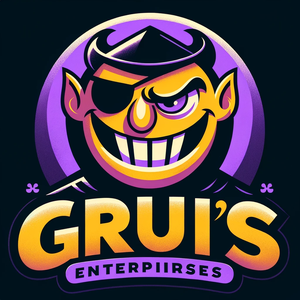

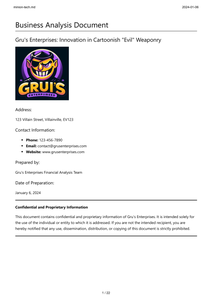

----------------------------------------------------------------------------------------------------
Summary The image is a logo for "Gru's Enterprises," featured prominently on the first page of a business analysis document titled "Gru's Enterprises: Innovation in Cartoonish 'Evil' Weaponry." The logo design is vibrant and playful, consistent with the theme of cartoonish villainy. It depicts a stylized, grinning face with exaggerated features, including an eyepatch and a mischievous expression, set against a purple background with the name "GRU'S ENTERPIIRSES" in bold, yellow lettering with a purple outline. This logo reflects the company's brand identity, emphasizing a whimsical and imaginative approach to its business offerings. The surrounding text on the page provides contact information, including the company's address at 123 Villain Street, Villainville, EV123, a phone number, email, and website. The document is prepared by Gru's Enterprises Financial Analysis Team, dated Januar

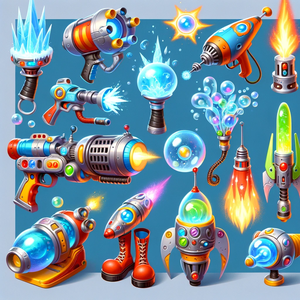

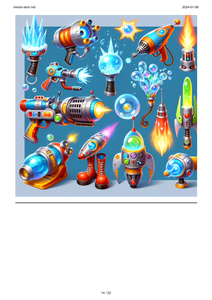

----------------------------------------------------------------------------------------------------
Summary The image is a vibrant and detailed illustration showcasing a collection of futuristic, sci-fi themed gadgets and weapons. The depicted items include various types of ray guns, energy emitters, and imaginative devices designed with a retro-futuristic aesthetic. Key features of these gadgets include bright colors, metallic surfaces, and glowing elements, highlighting their advanced and fantastical nature. 

- **Ray Guns**: Multiple ray guns are depicted, each with unique designs featuring colorful buttons, glowing barrels, and intricate detailing. Some guns emit icy blasts, while others have fiery or laser-like projections.
  
- **Energy Emitters**: Several devices appear to emit energy spheres or beams, with designs incorporating transparent globes, swirling lights, and spark-like features.

- **Rocket Boots**: Among the gadgets, a pair of red rocket boots with laces and metalli

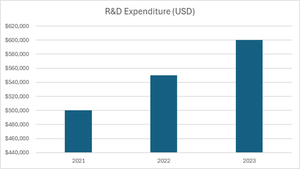

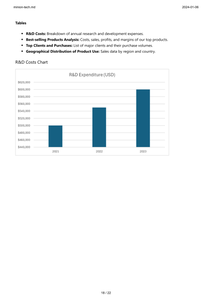

----------------------------------------------------------------------------------------------------
Summary The image is a bar chart titled "R&D Expenditure (USD)" and it illustrates the annual research and development expenses for the years 2021, 2022, and 2023. The chart features three vertical bars, each representing one year's expenditure. The expenditure values are as follows:

- For 2021, the R&D expenditure is approximately $500,000.
- For 2022, the expenditure increases to around $560,000.
- For 2023, the expenditure further rises to approximately $600,000.

The chart shows a consistent upward trend in R&D spending over the three-year period. The y-axis is labeled with a range from $440,000 to $620,000, while the x-axis lists the years 2021, 2022, and 2023. This visual representation is part of a section titled "R&D Costs Chart" on a page that also includes other financial analyses such as best-selling products, top clients, and geographical distribution of product use. The ch

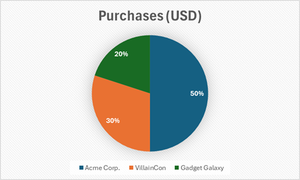

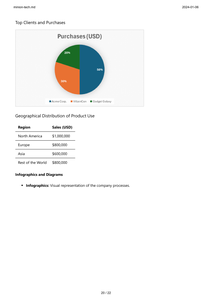

----------------------------------------------------------------------------------------------------
Summary The image titled "Purchases (USD)" is a pie chart representing the distribution of purchases among three top clients: Acme Corp., VillainCon, and Gadget Galaxy. The chart visually segments the total purchases into three distinct portions:

1. Acme Corp. - 50% of total purchases, represented by a blue segment.
2. VillainCon - 30% of total purchases, represented by an orange segment.
3. Gadget Galaxy - 20% of total purchases, represented by a green segment.

This pie chart is part of a section labeled "Top Clients and Purchases" on the page. The surrounding context includes a table titled "Geographical Distribution of Product Use," which lists sales figures across different regions, although these figures are not directly related to the pie chart. The page also mentions "Infographics and Diagrams," suggesting that the pie chart serves as a visual representation of company processe

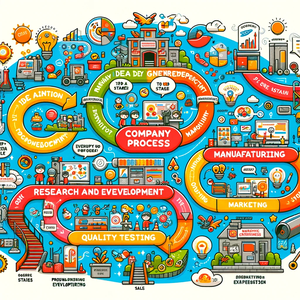

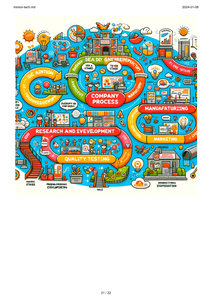

----------------------------------------------------------------------------------------------------
Summary The image is a vibrant and intricate infographic depicting the overall company process, emphasizing a flow from idea generation to sales. Central elements include:

1. **Main Idea Development**: Positioned at the top, this segment suggests the inception of ideas, with labels like "1PD A STAGES" and "TO 1DE STAGE," indicating stages of idea development. Illustrations of light bulbs and gears symbolize creativity and innovation.

2. **Company Process**: Centrally located, this section is labeled "COMPANY PROCESS," surrounded by various pathways indicating different stages and departments involved in the process. Illustrations of computers and workers imply ongoing analysis and management.

3. **Manufacturing**: On the right side, labeled "MANUAFATURIING," this area shows an assembly line, machines, and tools, suggesting the production phase. Visuals of charts and graphs indicate m

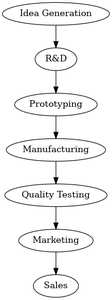

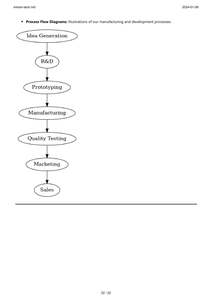

----------------------------------------------------------------------------------------------------
Summary The image depicts a process flow diagram illustrating the sequential stages of manufacturing and development processes as outlined in the document titled "minion-tech.md" dated January 6, 2024. The diagram consists of a vertical series of ellipses connected by arrows, representing the progression through different phases. The steps are as follows:

1. **Idea Generation**: The initial phase where concepts are formulated.
2. **R&D**: Research and Development stage, focusing on exploring and developing ideas.
3. **Prototyping**: Creating preliminary models to test and refine the concepts.
4. **Manufacturing**: The production stage where the finalized prototypes are manufactured.
5. **Quality Testing**: Ensuring the manufactured products meet quality standards.
6. **Marketing**: Strategies and efforts to promote the products.
7. **Sales**: The final stage where the products are sold

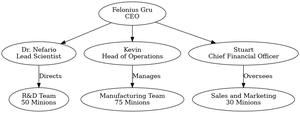

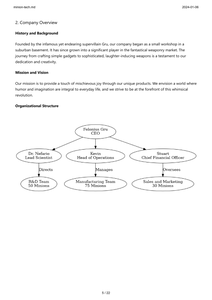

----------------------------------------------------------------------------------------------------
Summary The image is an organizational chart depicting the structure of a company founded by Felonius Gru, who serves as the CEO. The chart is part of a company overview section, specifically illustrating the organizational structure. At the top of the hierarchy is Felonius Gru, followed by three key positions:

1. **Dr. Nefario (Lead Scientist)**: Directs the R&D Team, which consists of 50 Minions.
2. **Kevin (Head of Operations)**: Manages the Manufacturing Team, comprising 75 Minions.
3. **Stuart (Chief Financial Officer)**: Oversees the Sales and Marketing Team, which includes 30 Minions.

Each position reports directly to Gru, indicating a centralized leadership structure. The visual uses arrows to denote reporting lines and responsibilities, with clear labels for roles and team sizes. The chart is presented as part of a document detailing the company's history and mission, emphasi

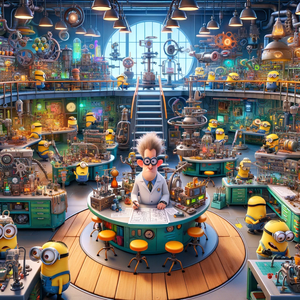

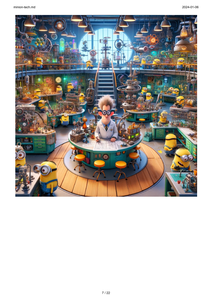

----------------------------------------------------------------------------------------------------
Summary The image depicts a vibrant and detailed laboratory setting with numerous Minions actively engaged in various scientific experiments and activities. The room is filled with an array of technological and mechanical equipment, including intricate machinery, colorful lights, and numerous scientific instruments. The laboratory is bustling with activity, showcasing Minions working at different stations, each with unique setups and devices. The environment is brightly lit, with overhead lamps and a large window providing natural light. The setting is organized around a central circular table, surrounded by stools, where a person in a white lab coat is seated, seemingly overseeing the operations or reviewing plans. This image is part of a document titled "minion-tech.md," dated January 6, 2024, appearing on page 7 of 22. The scene conveys a sense of innovation and collaboration among t

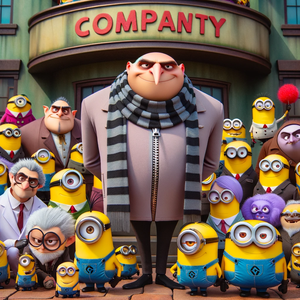

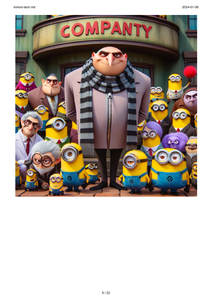

----------------------------------------------------------------------------------------------------
Summary The image depicts a group of animated characters, primarily Minions, standing in front of a building labeled "COMPANY." The characters are gathered around a central figure, surrounded by several Minions dressed in blue overalls with a logo on their chest. Some Minions are also wearing different attire, including suits, indicating a variety of roles or functions. The setting suggests a corporate environment or organization, with the Minions appearing to be part of a team or workforce. The presence of different characters in professional attire alongside the Minions reinforces the theme of teamwork or collaboration within the company context. The image is part of a document titled "minion-tech.md," dated January 6, 2024, and is located on page 9 of 22.
Completed for: 8


In [10]:
import os

def generate_img_summaries(path):
    """
    Generate summaries and base64 encoded strings for images
    path: Path to list of .jpg files extracted by Unstructured
    """
    # Store base64 encoded images
    img_base64_list = []
    # Store image summaries
    image_summaries = []

    # Apply to images
    for ind, img_file in enumerate(sorted(os.listdir(path))):
        page_num_of_image = int(img_file.split("_")[-2])
        if img_file.endswith(("jpeg", "jpg", "png")):
            image_within_page = os.path.join(path, img_file)
            print("This Image: ", image_within_page, "-----------Is on this page with location: ", png_files[page_num_of_image])
            print("The Content on that page is: ", context_per_page_number[page_num_of_image])
            ## base64 image present in pdf
            base64_image_within_page = encode_image(image_within_page)
            ## base64 image per page
            base64_image_png_file = encode_image(png_files[page_num_of_image])
            plt_img_base64(base64_image_within_page)
            plt_img_base64(base64_image_png_file)
            print("-"*100)
            try:
                ## will append only those images which are needed in our output
                img_base64_list.append(base64_image_within_page)
                ## will generate summary of both base 64 to get precise summary
                summary = image_summarize(base64_image_within_page,base64_image_png_file, context_per_page_number[page_num_of_image])
                print("Summary" , summary)
                image_summaries.append(summary)
                print("Completed for:", ind)
                print("="*100)
                
            except Exception as e:
                img_base64_list.pop() # if error occurs pop the added base 64
                print(f"Error processing {img_file}: {e}")

    return img_base64_list, image_summaries

# Image summaries
IMG_PATH = "extracted_images"
imgs_base64, image_summaries = generate_img_summaries(IMG_PATH)


In [11]:
len(imgs_base64), len(image_summaries)

(9, 9)

#### View the data

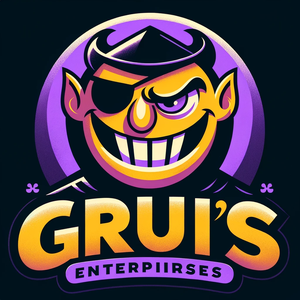

The image is a logo for "Gru's Enterprises," featured prominently on the first page of a business analysis document titled "Gru's Enterprises: Innovation in Cartoonish 'Evil' Weaponry." The logo design is vibrant and playful, consistent with the theme of cartoonish villainy. It depicts a stylized, grinning face with exaggerated features, including an eyepatch and a mischievous expression, set against a purple background with the name "GRU'S ENTERPIIRSES" in bold, yellow lettering with a purple outline. This logo reflects the company's brand identity, emphasizing a whimsical and imaginative approach to its business offerings. The surrounding text on the page provides contact information, including the company's address at 123 Villain Street, Villainville, EV123, a phone number, email, and website. The document is prepared by Gru's Enterprises Financial Analysis Team, dated January 6, 2024, and marked as containing confidential and proprietary information.
-------------------------------

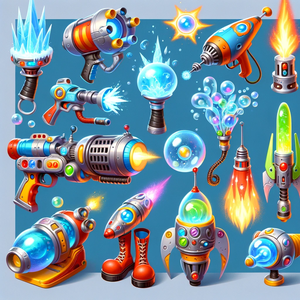

The image is a vibrant and detailed illustration showcasing a collection of futuristic, sci-fi themed gadgets and weapons. The depicted items include various types of ray guns, energy emitters, and imaginative devices designed with a retro-futuristic aesthetic. Key features of these gadgets include bright colors, metallic surfaces, and glowing elements, highlighting their advanced and fantastical nature. 

- **Ray Guns**: Multiple ray guns are depicted, each with unique designs featuring colorful buttons, glowing barrels, and intricate detailing. Some guns emit icy blasts, while others have fiery or laser-like projections.
  
- **Energy Emitters**: Several devices appear to emit energy spheres or beams, with designs incorporating transparent globes, swirling lights, and spark-like features.

- **Rocket Boots**: Among the gadgets, a pair of red rocket boots with laces and metallic components is present, suggesting the ability to fly or hover.

- **Mystical and Elemental Devices**: The i

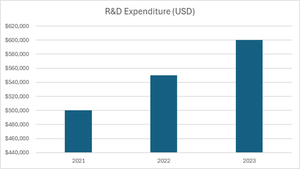

The image is a bar chart titled "R&D Expenditure (USD)" and it illustrates the annual research and development expenses for the years 2021, 2022, and 2023. The chart features three vertical bars, each representing one year's expenditure. The expenditure values are as follows:

- For 2021, the R&D expenditure is approximately $500,000.
- For 2022, the expenditure increases to around $560,000.
- For 2023, the expenditure further rises to approximately $600,000.

The chart shows a consistent upward trend in R&D spending over the three-year period. The y-axis is labeled with a range from $440,000 to $620,000, while the x-axis lists the years 2021, 2022, and 2023. This visual representation is part of a section titled "R&D Costs Chart" on a page that also includes other financial analyses such as best-selling products, top clients, and geographical distribution of product use. The chart is designed to provide a clear overview of the increasing investment in research and development activiti

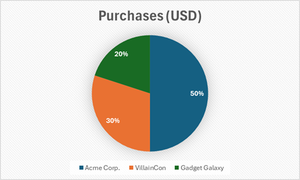

The image titled "Purchases (USD)" is a pie chart representing the distribution of purchases among three top clients: Acme Corp., VillainCon, and Gadget Galaxy. The chart visually segments the total purchases into three distinct portions:

1. Acme Corp. - 50% of total purchases, represented by a blue segment.
2. VillainCon - 30% of total purchases, represented by an orange segment.
3. Gadget Galaxy - 20% of total purchases, represented by a green segment.

This pie chart is part of a section labeled "Top Clients and Purchases" on the page. The surrounding context includes a table titled "Geographical Distribution of Product Use," which lists sales figures across different regions, although these figures are not directly related to the pie chart. The page also mentions "Infographics and Diagrams," suggesting that the pie chart serves as a visual representation of company processes, specifically focusing on client purchase distribution. The image is intended to provide a clear overview o

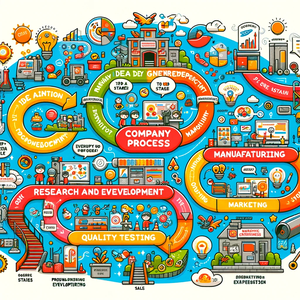

The image is a vibrant and intricate infographic depicting the overall company process, emphasizing a flow from idea generation to sales. Central elements include:

1. **Main Idea Development**: Positioned at the top, this segment suggests the inception of ideas, with labels like "1PD A STAGES" and "TO 1DE STAGE," indicating stages of idea development. Illustrations of light bulbs and gears symbolize creativity and innovation.

2. **Company Process**: Centrally located, this section is labeled "COMPANY PROCESS," surrounded by various pathways indicating different stages and departments involved in the process. Illustrations of computers and workers imply ongoing analysis and management.

3. **Manufacturing**: On the right side, labeled "MANUAFATURIING," this area shows an assembly line, machines, and tools, suggesting the production phase. Visuals of charts and graphs indicate monitoring and optimization.

4. **Research and Development**: Below the company process, the "RESEARCH AND EV

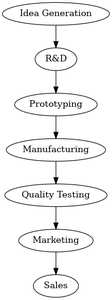

The image depicts a process flow diagram illustrating the sequential stages of manufacturing and development processes as outlined in the document titled "minion-tech.md" dated January 6, 2024. The diagram consists of a vertical series of ellipses connected by arrows, representing the progression through different phases. The steps are as follows:

1. **Idea Generation**: The initial phase where concepts are formulated.
2. **R&D**: Research and Development stage, focusing on exploring and developing ideas.
3. **Prototyping**: Creating preliminary models to test and refine the concepts.
4. **Manufacturing**: The production stage where the finalized prototypes are manufactured.
5. **Quality Testing**: Ensuring the manufactured products meet quality standards.
6. **Marketing**: Strategies and efforts to promote the products.
7. **Sales**: The final stage where the products are sold to customers.

This flow diagram is a concise representation of the structured approach used by the organiza

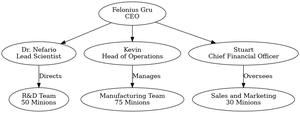

The image is an organizational chart depicting the structure of a company founded by Felonius Gru, who serves as the CEO. The chart is part of a company overview section, specifically illustrating the organizational structure. At the top of the hierarchy is Felonius Gru, followed by three key positions:

1. **Dr. Nefario (Lead Scientist)**: Directs the R&D Team, which consists of 50 Minions.
2. **Kevin (Head of Operations)**: Manages the Manufacturing Team, comprising 75 Minions.
3. **Stuart (Chief Financial Officer)**: Oversees the Sales and Marketing Team, which includes 30 Minions.

Each position reports directly to Gru, indicating a centralized leadership structure. The visual uses arrows to denote reporting lines and responsibilities, with clear labels for roles and team sizes. The chart is presented as part of a document detailing the company's history and mission, emphasizing its growth from a small workshop to a major player in the fantastical weaponry market, driven by imagina

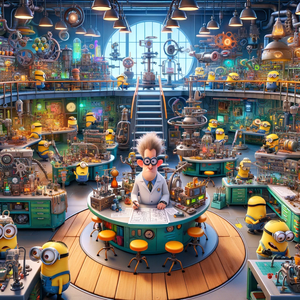

The image depicts a vibrant and detailed laboratory setting with numerous Minions actively engaged in various scientific experiments and activities. The room is filled with an array of technological and mechanical equipment, including intricate machinery, colorful lights, and numerous scientific instruments. The laboratory is bustling with activity, showcasing Minions working at different stations, each with unique setups and devices. The environment is brightly lit, with overhead lamps and a large window providing natural light. The setting is organized around a central circular table, surrounded by stools, where a person in a white lab coat is seated, seemingly overseeing the operations or reviewing plans. This image is part of a document titled "minion-tech.md," dated January 6, 2024, appearing on page 7 of 22. The scene conveys a sense of innovation and collaboration among the Minions as they engage in scientific endeavors.
----------------------------------------------------------

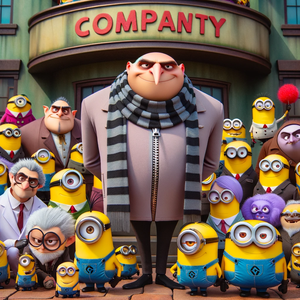

The image depicts a group of animated characters, primarily Minions, standing in front of a building labeled "COMPANY." The characters are gathered around a central figure, surrounded by several Minions dressed in blue overalls with a logo on their chest. Some Minions are also wearing different attire, including suits, indicating a variety of roles or functions. The setting suggests a corporate environment or organization, with the Minions appearing to be part of a team or workforce. The presence of different characters in professional attire alongside the Minions reinforces the theme of teamwork or collaboration within the company context. The image is part of a document titled "minion-tech.md," dated January 6, 2024, and is located on page 9 of 22.
----------------------------------------------------------------------------------------------------


In [12]:
for ind, img in enumerate(imgs_base64[:20]):
    plt_img_base64(img)
    print(image_summaries[ind])
    print("-"*100)


#### Create two Vectorstores and docstores (seperate for image and text for efficient retrieval) If you are running this first time

In [13]:
import pickle
import os

def save_docstore(var_name, var_value, filename="docstore.pkl"):
    """
    Saves a variable to a pickle file as a dictionary. 
    Adds new variables and overrides only if the variable name already exists.
    """
    # Load existing data if file exists
    if os.path.exists(filename):
        with open(filename, 'rb') as f:
            data = pickle.load(f)
    else:
        data = {}

    # Update or add the new variable
    data[var_name] = var_value

    # Save updated data
    with open(filename, 'wb') as f:
        pickle.dump(data, f)

    print(f"Variable '{var_name}' saved to {os.path.abspath(filename)}")
    
# save_docstore("var1", [1, 2, 3])
# save_docstore("var2", {"a": 1, "b": 2})
# save_docstore("var1", [100, 200])  # This will override var1



In [14]:
import uuid
from langchain.retrievers.multi_vector import MultiVectorRetriever
from langchain.storage import InMemoryStore
from langchain_chroma import Chroma
from langchain_core.documents import Document

text_collection = str(uuid.uuid4())  #For testing purposes
image_collection = str(uuid.uuid4())   #For testing purposes

# Create separate vector stores for text and images
text_vectorstore = Chroma(collection_name=text_collection, embedding_function=embeddings, persist_directory="chroma_text_store")
image_vectorstore = Chroma(collection_name=image_collection, embedding_function=embeddings, persist_directory="chroma_image_store")

# Initialize the Document storage layer
text_store = InMemoryStore() 
image_store = InMemoryStore()
id_key = "doc_id"

# Create multi-vector retrievers
text_retriever = MultiVectorRetriever(vectorstore=text_vectorstore, docstore=text_store, id_key=id_key)
image_retriever = MultiVectorRetriever(vectorstore=image_vectorstore, docstore=image_store, id_key=id_key)


# Helper function to add text documents
def add_text_documents(retriever, texts):
    doc_ids = [str(uuid.uuid4()) for _ in texts]
    docs = [
        Document(page_content=s, metadata={id_key: doc_ids[i]})
        for i, s in enumerate(texts)
    ]
    retriever.vectorstore.add_documents(docs)
    save_docstore("text_docstore", list(zip(doc_ids, texts)))
    retriever.docstore.mset(list(zip(doc_ids, texts)))
    
    return retriever

# Helper function to add image documents
def add_image_documents(retriever, image_summaries, imgs_base64):
    doc_ids = [str(uuid.uuid4()) for _ in imgs_base64]
    summary_docs = [
        Document(page_content=s, metadata={id_key: doc_ids[i]})
        for i, s in enumerate(image_summaries)
    ]
    retriever.vectorstore.add_documents(summary_docs)
    save_docstore("image_docstore", list(zip(doc_ids, imgs_base64)))
    retriever.docstore.mset(list(zip(doc_ids, imgs_base64)))
    return retriever

text_retriever = add_text_documents(text_retriever, texts)

image_retriever = add_image_documents(image_retriever, image_summaries, imgs_base64)


print("Text retriever and image retriever initialized successfully.")
save_docstore("text_collection", text_collection)
save_docstore("image_collection", image_collection)
print("Text Collection Name: ", text_collection)
print("Image Collection Name: ", image_collection)


python-dotenv could not parse statement starting at line 1
python-dotenv could not parse statement starting at line 1
python-dotenv could not parse statement starting at line 1
python-dotenv could not parse statement starting at line 1
python-dotenv could not parse statement starting at line 1
python-dotenv could not parse statement starting at line 1
python-dotenv could not parse statement starting at line 1
python-dotenv could not parse statement starting at line 1
python-dotenv could not parse statement starting at line 1


Variable 'text_docstore' saved to c:\Codes\01_Personal\00_Multimodels\tutorials\Langchain_pdf_text_and_image\docstore.pkl
Variable 'image_docstore' saved to c:\Codes\01_Personal\00_Multimodels\tutorials\Langchain_pdf_text_and_image\docstore.pkl
Text retriever and image retriever initialized successfully.
Variable 'text_collection' saved to c:\Codes\01_Personal\00_Multimodels\tutorials\Langchain_pdf_text_and_image\docstore.pkl
Variable 'image_collection' saved to c:\Codes\01_Personal\00_Multimodels\tutorials\Langchain_pdf_text_and_image\docstore.pkl
Text Collection Name:  569585b7-d824-473c-9793-6fc226ef8468
Image Collection Name:  c1ea1d82-7292-4950-bc15-c667fedb17c6


In [17]:
# ### To Delete collections
# text_vectorstore.delete_collection()
# image_vectorstore.delete_collection()

#### Query the vectorstore and docstore

In [16]:
#### Checking
query = "I want to know the first step of Vendor Invoice with FB60?"
retrieved_text = text_retriever.vectorstore.similarity_search(query, k= 5)
retrieved_image = image_retriever.vectorstore.similarity_search(query, k= 3)
print(len(retrieved_text), len(retrieved_image))
print("Text store count:", text_vectorstore._collection.count()) 
print("Image store count:", image_vectorstore._collection.count()) ##should be equal to count of images in your pdf

5 3
Text store count: 22
Image store count: 9


In [ ]:
### Both should be same, both of these hold images.
len(image_retriever.docstore.store),image_vectorstore._collection.count() # holding raw images, and sumaries of raw images

(9, 9)

#### Will get image from docstore with respect to summary retrived from vectorstore

In [18]:
### testing
query = "What is the steps 1 involved in vendor invoice?"
retrieved_image = image_retriever.vectorstore.similarity_search(query, k= 5)
print(retrieved_image)
for image_document_id in retrieved_image:
    doc = image_retriever.docstore.mget([image_document_id.metadata['doc_id']])
    print(doc)

[Document(id='db7300c2-6568-431c-9321-2288c0123456', metadata={'doc_id': '67a2d123-4ba7-4af2-9b1d-e56837f20db9'}, page_content='The image is a process flow diagram illustrating the sequence of stages in a manufacturing and development process. It comprises seven main steps, each depicted as an oval or ellipse connected by arrows indicating the process flow from top to bottom. The steps are as follows:\n\n1. **Idea Generation** - The initial stage where new concepts are developed.\n2. **R&D (Research and Development)** - The phase focused on researching and developing the idea into a viable product.\n3. **Prototyping** - Creating a prototype or model of the product for testing and refinement.\n4. **Manufacturing** - The process of producing the product on a larger scale.\n5. **Quality Testing** - Ensuring the product meets quality standards through rigorous testing.\n6. **Marketing** - Strategies and activities to promote and sell the product.\n7. **Sales** - The final step where the pr

#### Retrieving from a vector store (Most Imp Step)

In [ ]:
def retriever_multi_vector(query):
    retrieved_text = text_retriever.vectorstore.similarity_search(query, k= 10)
    retrieved_image = image_retriever.vectorstore.similarity_search(query, k= 5)
    # print(retrieved_image)
    docs=[]
    for page in retrieved_text:
        docs.append(page.page_content)
    for image_document_id in retrieved_image:
        ## Most imp step: we found top image summaries from vector store know docstore has doc_id which is common in this vector store. So we will get base4 from docstore
        doc = image_retriever.docstore.mget([image_document_id.metadata['doc_id']])
        # Can display images here
        # if doc[0] is not None:
        # plt_img_base64(doc[0])    #### Plot all the retrived images
        docs.extend(doc)
    return docs

query = "Process Flow Diagram?"
docs = retriever_multi_vector(query)
len(docs), docs ## length should be total of parameter k

(15,
 ['minion-tech.md 2024-01-06\n22 / 22\nProcess Flow Diagrams: Illustrations of our manufacturing and development processes.',
  'minion-tech.md 2024-01-06\n3 / 22\nCash Flow Statement\nTables\nR&D Costs\nBest-selling Products Analysis\nTop Clients and Purchases\nGeographical Distribution of Product Use\nInfographics and Diagrams\nOrganizational Chart\nProcess Flow Diagrams\nImages\nR&D Lab\nCompany Group Photo\nClose-ups of Cartoon Weapons',
  'minion-tech.md 2024-01-06\n10 / 22\n6. Operational Overview\nManufacturing Process\nOur manufacturing process is streamlined for efficiency and innovation. The workflow is divided into several\nstages:\n1. Design and Prototyping: Led by Dr. Nefario and his team, this stage involves brainstorming, sketching,\nand creating prototypes.\n2. Material Sourcing: We source high-quality, durable materials, ensuring our products are safe and\nlong-lasting.\n3. Assembly: Minions handle the assembly with precision and care, adhering to strict quality c

#### Seperate Results of image and text

In [27]:
import re
import base64

# helps in detecting base64 encoded strings
def looks_like_base64(sb):
    """Check if the string looks like base64"""
    return re.match("^[A-Za-z0-9+/]+[=]{0,2}$", sb) is not None

# helps in checking if the base64 encoded image is actually an image
def is_image_data(b64data):
    """
    Check if the base64 data is an image by looking at the start of the data
    """
    image_signatures = {
        b"\xff\xd8\xff": "jpg",
        b"\x89\x50\x4e\x47\x0d\x0a\x1a\x0a": "png",
        b"\x47\x49\x46\x38": "gif",
        b"\x52\x49\x46\x46": "webp",
    }
    try:
        header = base64.b64decode(b64data)[:8]  # Decode and get the first 8 bytes
        for sig, format in image_signatures.items():
            if header.startswith(sig):
                return True
        return False
    except Exception:
        return False

# returns a dictionary separating images and text (with table) elements
def split_image_text_types(docs):
    """
    Split base64-encoded images and texts (with tables).
    """
    b64_images = {}
    texts = []

    image_ind=0
    for doc in docs:
        # Check if the document is of type Document and extract page_content if so
        if isinstance(doc, Document):
            doc = doc.page_content

        # Ensure doc is a string
        if isinstance(doc, bytes):
            doc = doc.decode('utf-8')

        if looks_like_base64(doc) and is_image_data(doc):
            b64_images[image_ind] = doc
            image_ind+=1
        else:
            texts.append(doc)

    return {"images": b64_images, "texts": texts}


In [28]:
# # Check retrieval
# query="I want to know the first step of Vendor Invoice?"
# docs = retriever_multi_vector(query)
# context = split_image_text_types(docs)
# len(docs), context

#### LLM Pipeline

In [29]:
from operator import itemgetter
from langchain_core.runnables import RunnableLambda, RunnablePassthrough
from langchain_core.messages import HumanMessage
from langchain_core.output_parsers import StrOutputParser

def multimodal_prompt_function(data_dict):
    formatted_texts = "\n".join(data_dict["context"]["texts"])
    messages = []

    if data_dict["context"]["images"]:
        for idx, image_base64 in data_dict["context"]["images"].items():
            image_message = {
                "type": "image_url",
                "image_url": {"url": f"data:image/jpeg;base64,{image_base64}"},
                "metadata": {"index": idx}
            }
            messages.append(image_message)

    text_message = {
        "type": "text",
        "text": (
            f"""You are an AI assistant analyzing a mix of text and image data.
            Your task is to:
            1. Answer the user’s question based on the provided text and images.
            2. Identify which image (if any) is most relevant to the question and return its index.

            User question:
            {data_dict['question']}

            Context documents:
            {formatted_texts}

            List of images and their indices:
            {[(idx, "Image available") for idx in data_dict["context"]["images"].keys()]}

            Expected Output Format (JSON):
            {{
                answer: str = Field(description="Answer to user query.")
                image_index: list[int] = Field(description="index of the most relevant image or -1 if none")
            }}

            Answer:
            """
        ),
    }
    messages.append(text_message)

    return [HumanMessage(content=messages)]

# Create multimodal RAG pipeline
multimodal_rag = (
    {
        "context": itemgetter('context'),
        "question": itemgetter('input'),
    }
    | RunnableLambda(multimodal_prompt_function)
    | llm
    | StrOutputParser()
)

# Retrieve documents and images
retrieve_docs = (
    itemgetter('input')
    | RunnableLambda(retriever_multi_vector)
    | RunnableLambda(split_image_text_types)
)

# Assign context and response
multimodal_rag_w_sources = (
    RunnablePassthrough.assign(context=retrieve_docs)
    .assign(response=multimodal_rag)
)


In [30]:
# ###### Trial Run
import json
def format_response(response):
    result = re.sub(r"json|```", "", response['response'])
    result = json.loads(result)
    print(json.dumps(result, indent=2))
    # print("-"*50)
    if result['image_index']!=-1: # no image is relevant to user query
      for ind, info in enumerate(result['image_index']):
          if info in response['context']['images']:
              result['image_index'][ind] = response['context']['images'][info]
    # print(json.dumps(result, indent=2))
    return result
    result.keys()

# response = multimodal_rag_w_sources.invoke({'input': "Give me profit and Loss statement? "})
# print(response)
# result = format_response(response)

#### Display final Answer

In [31]:
from IPython.display import HTML, display, Image, Markdown
from PIL import Image
import base64
from io import BytesIO

def plt_img_base64(img_base64):
    """Display base64 encoded string as an image."""
    try:
        # Decode the base64 string
        img_data = base64.b64decode(img_base64)
        # Create a BytesIO object
        img_buffer = BytesIO(img_data)
        # Open the image using PIL
        img = Image.open(img_buffer)
        display(img)
    except Exception as e:
      pass
        # print(f"Error displaying image: {e}")

def multimodal_rag_qa(query):
    """Retrieve and display the answer along with relevant images."""
    response = multimodal_rag_w_sources.invoke({'input': query})
    print(response)
    result = format_response(response)
    print('==' * 50)
    print(json.dumps(result, indent=2))
    print('==' * 50)
    print('**Answer:**')
    print(result['answer'])

    print('--' * 50)
    if result['image_index']!=-1: # no image is relevant to user query
      for ind in range(len(result['image_index'])):
          plt_img_base64(result['image_index'][ind])
          print()
    print('==' * 50)


{'input': 'What are the Top Clients and Purchases?', 'context': {'images': {0: 'iVBORw0KGgoAAAANSUhEUgAAAeEAAAEgCAIAAAAMnFxIAAAACXBIWXMAAA7EAAAOxAGVKw4bAAEAxUlEQVR4nOy9d5hsVZX3P//8nhElSJIkyTSDjhP0dcZ33plxRl8V1NEXHZULl3gT3EsWkHAT+YIEJQiCJAFBcg5XchIkp6ZzTjfR1VXVFbuqft8+X85inbPP2bVPdbh4L/3U08/p05/ateuEtddea+3v+ave3t6Ojo53on6am5sj98f9fMh/yGvmQ/5D/kN+Mnx7e3tPT89fwUAPDAykUqlMJjM6OrpmzZp33313bGwM26tWrRoZGeE295NZt24d9rvza9euxf5sNovt1atXf8i78Dgjdp7bU8JjO1F/po/Hb+Glz8JjvyOPPcJLHz74PI/J9PGO/cEe4bHHwqO1aeLx+wPCyzExeTJTxWNb8zxTMNN/BWtNqFwu12o1/MZ2qVTCdrFYzOVysh9fAHuwPT4+jm0Xnvu5zf3YU5fH7xDP7WnihWmMx9GYWj7U/zie++PaJ5OUlz4k4rFfeH0MP+Q1X6lUppAn494fzRQKhcj2sd+Rl/35fH5qed2HDYOX4yAMdrrwdLZgnydsNCw6ODnlQOGq0BzjPTDq3I/3SLfwFhc+nU5rXrpi56vVKnn5GjPA05zhOLjwYITHCMfv5cLToZBjEsmzz+uF5zkCn/F+HHlgM8/LOUrE03lx4YUBz/1xPK+Zujz+jORxH4Z4Hn9HHtuh81WXt/c/kseFpPujj6EjL4zw0ocQz3PaGJ/xJgqJeL0dyetzSh4H3J1Hf6rej5xTHDoXHv2EZ93c3PyeH03LjX/jgOLf2MY7YVzwTo4AuHBrnjcHmNsuPG48zaNn2I7k0Y7w2C/tmzxHrTge25G87k+Ilz7wvQ3w/F52XvfHzpv9j+Tx

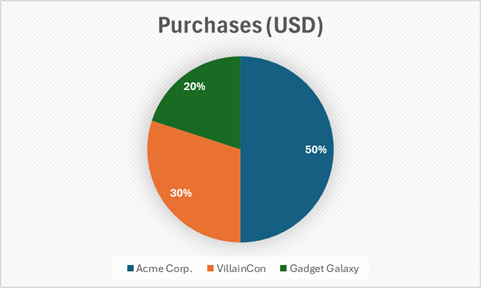

In [35]:
query ="What are the Top Clients and Purchases?"
multimodal_rag_qa(query)